In [25]:
# Initial Dependencies
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import os

In [65]:
uber = pd.read_csv('Data/Uber_Cleaned.csv', index_col=[0])
uber.head()

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,distance_miles,year,month,day,hour,minute,weekday
0,10.5,2011-04-18 19:55:00,-73.984565,40.745372,-73.951843,40.777743,5,2.820051,2011,4,18,19,55,0
1,12.0,2014-01-09 07:48:00,-73.991572,40.749877,-73.964142,40.757180,1,1.523471,2014,1,9,7,48,3
2,9.0,2014-09-14 01:14:00,-74.000412,40.718410,-73.999255,40.719967,2,0.123604,2014,9,14,1,14,6
3,9.3,2012-03-18 15:04:01,-73.991999,40.719834,-73.983515,40.743818,1,1.717548,2012,3,18,15,4,6
4,8.5,2012-02-06 13:09:00,-73.966765,40.761547,-73.990493,40.750787,1,1.449010,2012,2,6,13,9,0


In [66]:
uber = uber.dropna()

In [67]:
uber['weekday'] = uber['weekday'].apply(lambda x: x + 1)
uber['log_fare'] = np.log2(uber['fare_amount'])
uber.head()

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,distance_miles,year,month,day,hour,minute,weekday,log_fare
0,10.5,2011-04-18 19:55:00,-73.984565,40.745372,-73.951843,40.777743,5,2.820051,2011,4,18,19,55,1,3.392317
1,12.0,2014-01-09 07:48:00,-73.991572,40.749877,-73.964142,40.757180,1,1.523471,2014,1,9,7,48,4,3.584963
2,9.0,2014-09-14 01:14:00,-74.000412,40.718410,-73.999255,40.719967,2,0.123604,2014,9,14,1,14,7,3.169925
3,9.3,2012-03-18 15:04:01,-73.991999,40.719834,-73.983515,40.743818,1,1.717548,2012,3,18,15,4,7,3.217231
4,8.5,2012-02-06 13:09:00,-73.966765,40.761547,-73.990493,40.750787,1,1.449010,2012,2,6,13,9,1,3.087463


In [68]:
# Assign X (data) and y (target)
X = uber[['weekday', 'hour', 'passenger_count', 'distance_miles']]
y = uber["log_fare"].values.reshape(-1, 1)
print(X.shape, y.shape)

(205624, 4) (205624, 1)


In [69]:
# Split the data into training and testing
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

In [70]:
from sklearn.preprocessing import StandardScaler

# Create a StandardScaler model and fit it to the training data

X_scaler = StandardScaler().fit(X_train)
y_scaler = StandardScaler().fit(y_train)

In [71]:
# Transform the training and testing data using the X_scaler and y_scaler models

X_train_scaled = X_scaler.transform(X_train)
X_test_scaled = X_scaler.transform(X_test)
y_train_scaled = y_scaler.transform(y_train)
y_test_scaled = y_scaler.transform(y_test)

In [72]:
# Create a LinearRegression model and fit it to the scaled training data

from sklearn.linear_model import LinearRegression
model = LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)
model.fit(X_train_scaled, y_train_scaled)

LinearRegression()

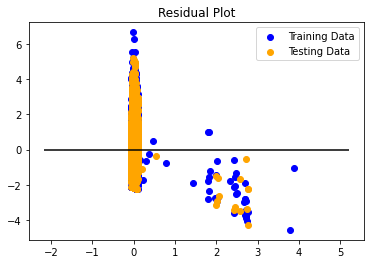

In [73]:
# Make predictions using a fitted model
# Plot the difference between the model predicted values and actual y values, versus the model predicted values
# Hint: You can predict values of X training and testing data using the model.predict() method on a fitted model

predictions = model.predict(X_test_scaled)
model.fit(X_train_scaled, y_train_scaled)
plt.scatter(model.predict(X_train_scaled), y_train_scaled - model.predict(X_train_scaled), c="blue", label="Training Data")
plt.scatter(model.predict(X_test_scaled), y_test_scaled - model.predict(X_test_scaled), c="orange", label="Testing Data")
plt.legend()
plt.hlines(y=0, xmin=y_test_scaled.min(), xmax=y_test_scaled.max())
plt.title("Residual Plot")
plt.show()

In [74]:
# Used X_test_scaled, y_test_scaled, and model.predict(X_test_scaled) to calculate MSE and R2

from sklearn.metrics import mean_squared_error

MSE = mean_squared_error(y_test_scaled, predictions)
r2 = model.score(X_test_scaled, y_test_scaled)

print(f"MSE: {MSE}, R2: {r2}")

MSE: 1.004333637006309, R2: 0.0016098299776556857


In [75]:
# LASSO model
# Note: Use an alpha of .01 when creating the model for this activity
from sklearn.linear_model import Lasso

### BEGIN SOLUTION
lasso = Lasso(alpha=.01).fit(X_train_scaled, y_train_scaled)

predictions = lasso.predict(X_test_scaled)

MSE = mean_squared_error(y_test_scaled, predictions)
r2 = lasso.score(X_test_scaled, y_test_scaled)
### END SOLUTION

print(f"MSE: {MSE}, R2: {r2}")

MSE: 1.004565023020951, R2: 0.0013798132640983063


In [76]:
# Ridge model
# Note: Use an alpha of .01 when creating the model for this activity
from sklearn.linear_model import Ridge

### BEGIN SOLUTION
ridge = Ridge(alpha=.01).fit(X_train_scaled, y_train_scaled)

predictions = ridge.predict(X_test_scaled)

MSE = mean_squared_error(y_test_scaled, predictions)
r2 = ridge.score(X_test_scaled, y_test_scaled)
### END SOLUTION

print(f"MSE: {MSE}, R2: {r2}")

MSE: 1.0043336369643607, R2: 0.0016098300193555515


In [77]:
# ElasticNet model
# Note: Use an alpha of .01 when creating the model for this activity
from sklearn.linear_model import ElasticNet

### BEGIN SOLUTION
elasticnet = ElasticNet(alpha=.01).fit(X_train_scaled, y_train_scaled)

predictions = elasticnet.predict(X_test_scaled)

MSE = mean_squared_error(y_test_scaled, predictions)
r2 = elasticnet.score(X_test_scaled, y_test_scaled)
### END SOLUTION

print(f"MSE: {MSE}, R2: {r2}")

MSE: 1.004351015068903, R2: 0.0015925547553303776


In [ ]:
# Questions for Renan 05/05/21
# Maybe the data is non-linear? Why is MSE extremely high, and R2 extremely low??
# Maybe the data isnt correlated? (Excel correlation test had nothing close to 0.5)
# Use a different test besides multiple lin/nonlin regression?
# Ask renan about logging fare_amount column (unsure how to do it correctly)